In [ ]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.figure_factory as ff
import plotly.graph_objects as go
from sklearn.preprocessing import LabelEncoder
from scipy.stats import kruskal
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import RobustScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.tree import DecisionTreeRegressor

%matplotlib inline
sns.set_theme(style="dark")
mpl.rcParams['axes.unicode_minus'] = False
pd.set_option('display.max_columns',None)
plt.style.use('seaborn-dark-palette')
plt.style.use('dark_background')

<ipython-input-1-7551f446fce7>:22: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn-dark-palette')


In [ ]:
from google.colab import files

files.upload()

{}

In [ ]:
data = pd.read_csv("Airbnb_Open_Data.csv", encoding='utf-8')
data.head()

<ipython-input-3-f4069092403e>:1: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv("Airbnb_Open_Data.csv", encoding='utf-8')


,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,US,False,strict,Private room,2020.0,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,US,False,moderate,Entire home/apt,2007.0,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,US,True,flexible,Private room,2005.0,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,US,True,moderate,Entire home/apt,2005.0,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,US,False,moderate,Entire home/apt,2009.0,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",NaN


## General Preprocessing

In [ ]:
# Change all column names to have underscore "_" instead of space and to only include lowercase letters
data.rename(columns=lambda x: x.replace(' ', '_'), inplace=True)
data.columns = data.columns.str.lower()

In [ ]:
data.dtypes

id                                  int64
name                               object
host_id                             int64
host_identity_verified             object
host_name                          object
neighbourhood_group                object
neighbourhood                      object
lat                               float64
long                              float64
country                            object
country_code                       object
instant_bookable                   object
cancellation_policy                object
room_type                          object
construction_year                 float64
price                              object
service_fee                        object
minimum_nights                    float64
number_of_reviews                 float64
last_review                        object
reviews_per_month                 float64
review_rate_number                float64
calculated_host_listings_count    float64
availability_365                  

In [ ]:
#Change price & service fee to int number :
data['price'] = pd.to_numeric(data['price'].replace({'\$': '', ',': ''}, regex=True), errors='coerce')
data['service_fee'] = pd.to_numeric(data['service_fee'].replace({'\$': '', ',': ''}, regex=True), errors='coerce')

In [ ]:
#fix neighborhoods
data['neighbourhood_group'] = data['neighbourhood_group'].replace({'brookln': 'Brooklyn', 'manhatan': 'Manhattan'})

In [ ]:
# fix data types
data["id"] = data["id"].astype(str)
data["host_id"] = data["host_id"].astype(str)
data["construction_year"] = pd.to_datetime(data["construction_year"], format='%Y').dt.year
data["last_review"] = pd.to_datetime(data["last_review"])

In [ ]:
# Change all column names to have underscore "_" instead of space
data.rename(columns=lambda x: x.replace(' ', '_'), inplace=True)

In [ ]:
print(data.isna().sum(), "\n")
round(((data.isna().sum()/len(data))*100), 2)

id                                     0
name                                 250
host_id                                0
host_identity_verified               289
host_name                            406
neighbourhood_group                   29
neighbourhood                         16
lat                                    8
long                                   8
country                              532
country_code                         131
instant_bookable                     105
cancellation_policy                   76
room_type                              0
construction_year                    214
price                                247
service_fee                          273
minimum_nights                       409
number_of_reviews                    183
last_review                        15893
reviews_per_month                  15879
review_rate_number                   326
calculated_host_listings_count       319
availability_365                     448
house_rules     

id                                  0.00
name                                0.24
host_id                             0.00
host_identity_verified              0.28
host_name                           0.40
neighbourhood_group                 0.03
neighbourhood                       0.02
lat                                 0.01
long                                0.01
country                             0.52
country_code                        0.13
instant_bookable                    0.10
cancellation_policy                 0.07
room_type                           0.00
construction_year                   0.21
price                               0.24
service_fee                         0.27
minimum_nights                      0.40
number_of_reviews                   0.18
last_review                        15.49
reviews_per_month                  15.48
review_rate_number                  0.32
calculated_host_listings_count      0.31
availability_365                    0.44
house_rules     

In [ ]:
# Drop missing values in price
data = data.dropna(subset=["price"])

# Drop license that is missing all values
data.drop(["license"], axis = 1, inplace = True)

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
lat,102344.0,40.728090,0.055870,40.49979,40.68873,40.72228,40.76276,40.91697
long,102344.0,-73.949647,0.049522,-74.24984,-73.98257,-73.95444,-73.93235,-73.70522
construction_year,102142.0,2012.487038,5.765066,2003.00000,2007.00000,2012.00000,2017.00000,2022.00000
price,102352.0,625.293536,331.671614,50.00000,340.00000,624.00000,913.00000,1200.00000
service_fee,102113.0,125.038399,66.333513,10.00000,68.00000,125.00000,183.00000,240.00000
minimum_nights,101943.0,8.125619,30.556607,-1223.00000,2.00000,3.00000,5.00000,5645.00000
number_of_reviews,102169.0,27.487878,49.521341,0.00000,1.00000,7.00000,30.00000,1024.00000
reviews_per_month,86500.0,1.375068,1.747680,0.01000,0.22000,0.74000,2.01000,90.00000
review_rate_number,102026.0,3.279282,1.284458,1.00000,2.00000,3.00000,4.00000,5.00000
calculated_host_listings_count,102033.0,7.927200,32.211222,1.00000,1.00000,1.00000,2.00000,332.00000


In [ ]:
data.describe(include = "object").T

,count,unique,top,freq
id,102352,101811,6048806,2
name,102105,61135,Home away from home,32
host_id,102352,101810,85335405136,2
host_identity_verified,102067,2,unconfirmed,51087
host_name,101951,13176,Michael,877
neighbourhood_group,102324,5,Manhattan,43683
neighbourhood,102337,224,Bedford-Stuyvesant,7921
country,101825,1,United States,101825
country_code,102226,1,US,102226
instant_bookable,102252,2,False,51354


## Julia: *Price, Service Fee & Reviews*

### Price & Service Fee Analysis

In [ ]:
data[["price", "service_fee"]].head()

,price,service_fee
0,966.0,193.0
1,142.0,28.0
2,620.0,124.0
3,368.0,74.0
4,204.0,41.0


In [ ]:
data[["price", "service_fee"]].describe()

,price,service_fee
count,102352.000000,102113.000000
mean,625.293536,125.038399
std,331.671614,66.333513
min,50.000000,10.000000
25%,340.000000,68.000000
50%,624.000000,125.000000
75%,913.000000,183.000000
max,1200.000000,240.000000


In [ ]:
data.isna().sum()

id                                    0
name                                247
host_id                               0
host_identity_verified              285
host_name                           401
neighbourhood_group                  28
neighbourhood                        15
lat                                   8
long                                  8
country                             527
country_code                        126
instant_bookable                    100
cancellation_policy                  71
room_type                             0
construction_year                   210
price                                 0
service_fee                         239
minimum_nights                      409
number_of_reviews                   183
last_review                       15867
reviews_per_month                 15852
review_rate_number                  326
calculated_host_listings_count      319
availability_365                    448
house_rules                       51996


In [ ]:
data = data.loc[data["price"].notna()]
data = data.loc[data["service_fee"].isna()==0]

<ipython-input-18-66943625913a>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = data[quantitative_col].corr()


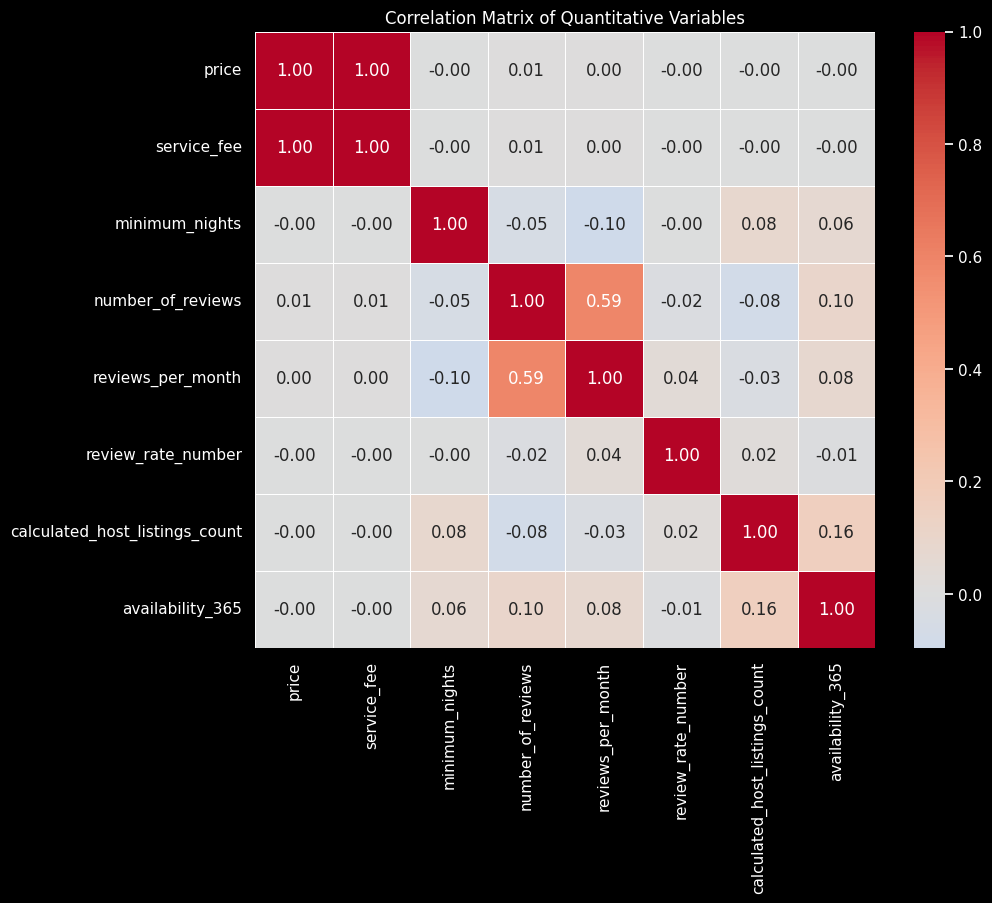

In [ ]:
quantitative_col = ['price', 'service_fee', 'minimum_nights', 'number_of_reviews', 'last_review', 'reviews_per_month', 'review_rate_number', 'calculated_host_listings_count', 'availability_365']
correlation_matrix = data[quantitative_col].corr()

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix of Quantitative Variables')
plt.show()

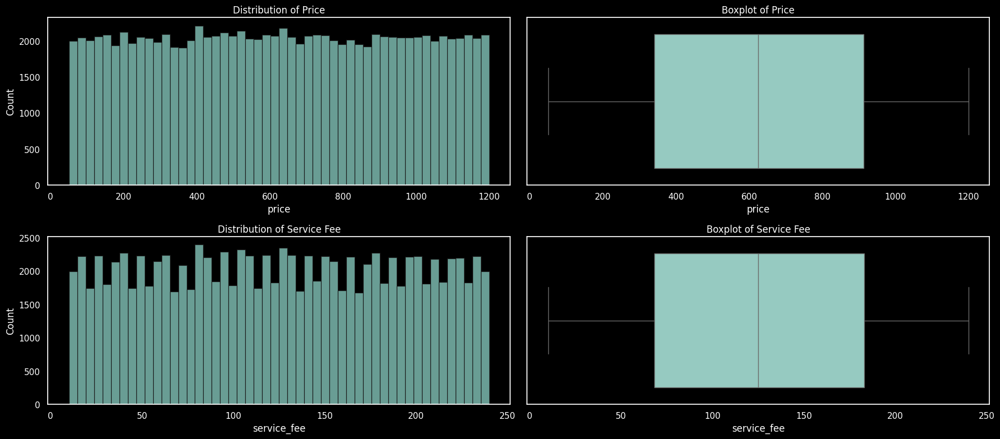

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(18, 8))

sns.histplot(data["price"], bins=50, edgecolor="k", ax=axes[0, 0])
axes[0, 0].set_title("Distribution of Price")

sns.boxplot(x=data["price"], ax=axes[0, 1])
axes[0, 1].set_title("Boxplot of Price")

sns.histplot(data["service_fee"], bins=50, edgecolor="k", ax=axes[1, 0])
axes[1, 0].set_title("Distribution of Service Fee")

sns.boxplot(x=data["service_fee"], ax=axes[1, 1])
axes[1, 1].set_title("Boxplot of Service Fee")

plt.tight_layout()
plt.show()

#### Price

In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("neighbourhood")])

print("Kruskal-Wallis H-test on Price - Neighbourhood:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Neighbourhood:
H-statistic: 391.0681741564709
p-value: 2.4716164667633007e-11


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("neighbourhood_group")])

print("Kruskal-Wallis H-test on Price - Neighbourhood Group:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Neighbourhood Group:
H-statistic: 6.517528745056742
p-value: 0.16368927585473067


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["price"] for name, group in data.groupby("host_identity_verified")])

print("Kruskal-Wallis H-test on Price - Host Identity Verified:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Price - Host Identity Verified:
H-statistic: 1.7260596232326215
p-value: 0.18891490333341318


The null hypothesis is that the medians of the price distributions are equal across all groups.

Comparing, the test on Price resulted in a very low p-value (significantly below 0.05), indicating that there is a statistically significant difference in the distribution of prices between different neighborhoods. This suggests that at least one neighborhood's median price is significantly different from others.

On the other hand, the test on Neighbourhood Groups and Host Identity Verified resulted in a p-value greater than 0.05, which means there is no statistically significant difference in the distribution of prices between the different neighborhood groups and the host being verified or not.

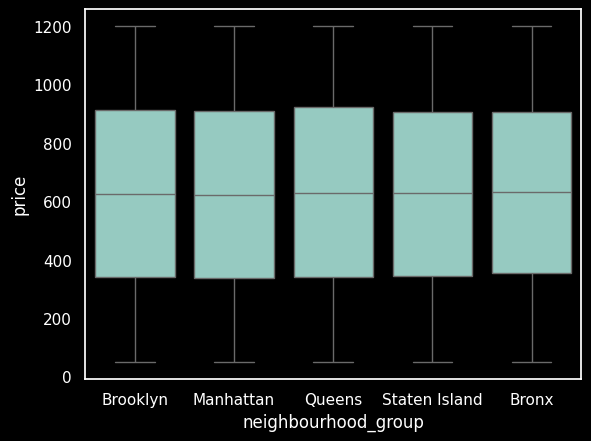

In [ ]:
sns.boxplot(x="neighbourhood_group", y="price", data = data)
plt.show()

In [ ]:
data.groupby("neighbourhood_group")["price"].mean().sort_values(ascending = False)

neighbourhood_group
Queens           630.128854
Bronx            627.678519
Brooklyn         626.325410
Staten Island    624.288421
Manhattan        622.449329
Name: price, dtype: float64

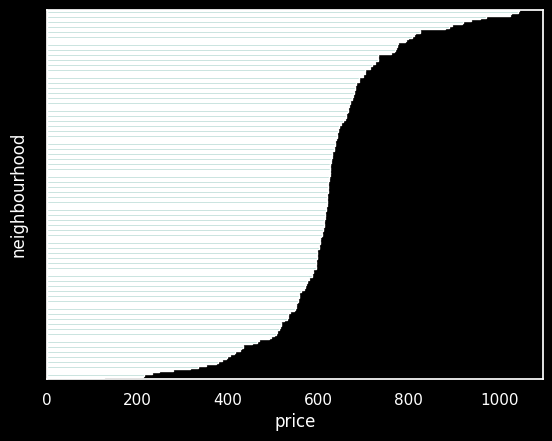

In [ ]:
data_summary = data.groupby('neighbourhood')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='neighbourhood', x='price')
plt.gca().set_yticklabels([])
plt.show()

In [ ]:
data.groupby("neighbourhood")["price"].median().sort_values(ascending = False)

neighbourhood
New Dorp                  1044.0
Chelsea, Staten Island    1042.0
Woodrow                   1025.0
Fort Wadsworth            1024.0
Jamaica Hills              971.0
                           ...  
Rossville                  247.0
Breezy Point               232.0
Spuyten Duyvil             215.0
Richmondtown               212.0
Lighthouse Hill            127.0
Name: price, Length: 224, dtype: float64

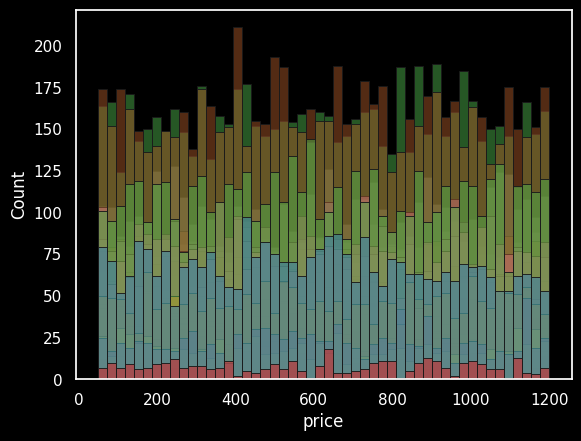

In [ ]:
ax = sns.histplot(data, x="price", bins=50, edgecolor="k", alpha=0.5, hue="neighbourhood", palette="Set1")
ax.legend_.remove()
plt.show()

This plot is to show that the main difference between neighbourhoods is the amount of airbnbs, and the price distribution is very similarly distributed amoung all neighbourhoods.

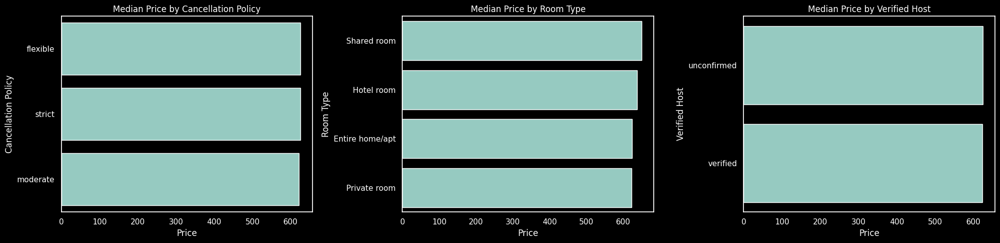

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

# Plot for cancellation policy
data_summary = data.groupby('cancellation_policy')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='cancellation_policy', x='price', ax=axes[0])
axes[0].set_title('Median Price by Cancellation Policy')
axes[0].set_xlabel('Price')
axes[0].set_ylabel('Cancellation Policy')

# Plot for room type
data_summary = data.groupby('room_type')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='room_type', x='price', ax=axes[1])
axes[1].set_title('Median Price by Room Type')
axes[1].set_xlabel('Price')
axes[1].set_ylabel('Room Type')

# Plot for room type
data_summary = data.groupby('host_identity_verified')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='host_identity_verified', x='price', ax=axes[2])
axes[2].set_title('Median Price by Verified Host')
axes[2].set_xlabel('Price')
axes[2].set_ylabel('Verified Host')

plt.tight_layout()
plt.show()

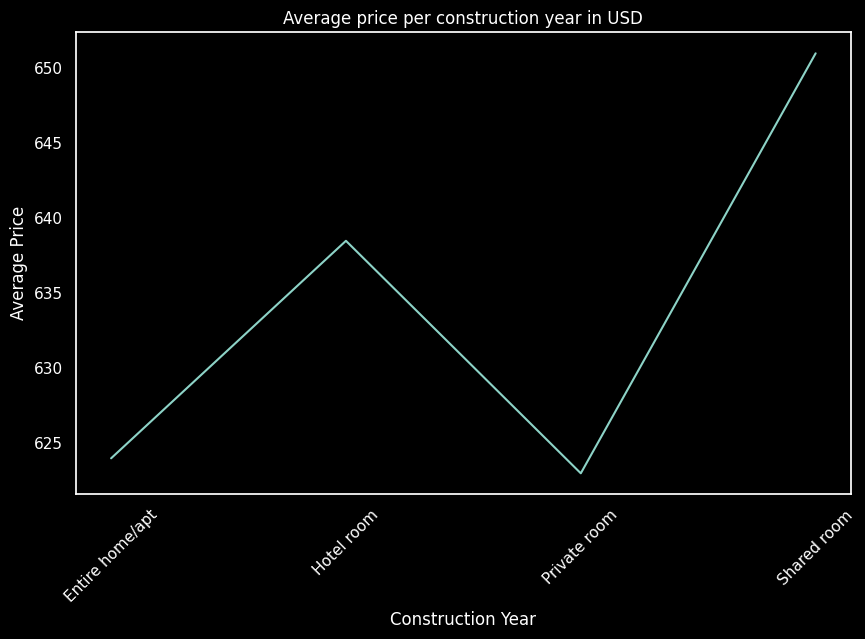

In [ ]:
price_per_year = data.groupby('room_type')['price'].median().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(data=price_per_year, x="room_type", y="price")
plt.title("Average price per construction year in USD")
plt.xlabel("Construction Year")
plt.ylabel("Average Price")
plt.xticks(ticks = price_per_year["room_type"], rotation=45)
plt.show()

#### Service Fee

In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("neighbourhood")])

print("Kruskal-Wallis H-test on Service Fee - Neighbourhood:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Neighbourhood:
H-statistic: 391.1283991683172
p-value: 2.4389933907835417e-11


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("neighbourhood")])

print("Kruskal-Wallis H-test on Service Fee - Neighbourhood:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Neighbourhood:
H-statistic: 391.1283991683172
p-value: 2.4389933907835417e-11


In [ ]:
# Perform Kruskal-Wallis H-test
h_statistic, p_value = kruskal(*[group["service_fee"] for name, group in data.groupby("host_identity_verified")])

print("Kruskal-Wallis H-test on Service Fee - Host Identity Verified:")
print("H-statistic:", h_statistic)
print("p-value:", p_value)

Kruskal-Wallis H-test on Service Fee - Host Identity Verified:
H-statistic: 1.7277534996195976
p-value: 0.18869805084715752


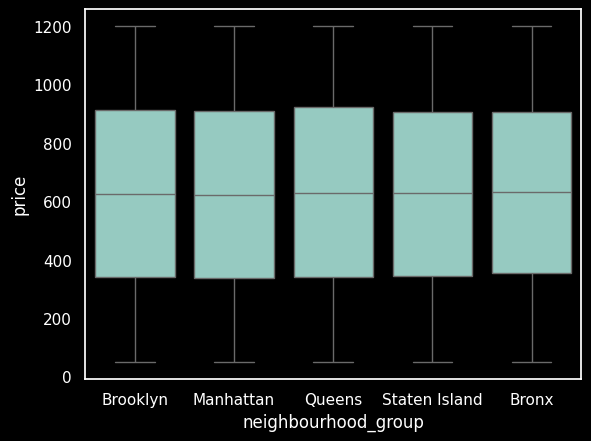

In [ ]:
sns.boxplot(x="neighbourhood_group", y="price", data = data)
plt.show()

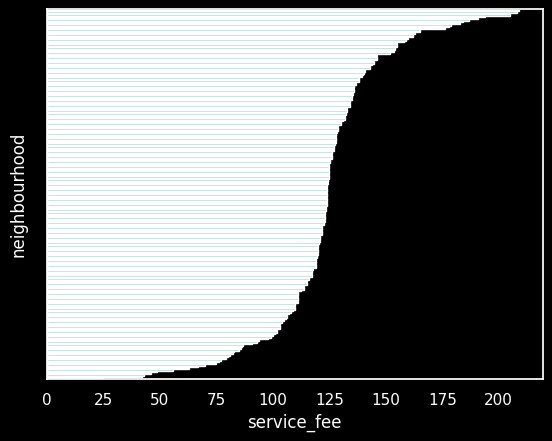

In [ ]:
data_summary = data.groupby('neighbourhood')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='neighbourhood', x='service_fee')
plt.gca().set_yticklabels([])
plt.show()

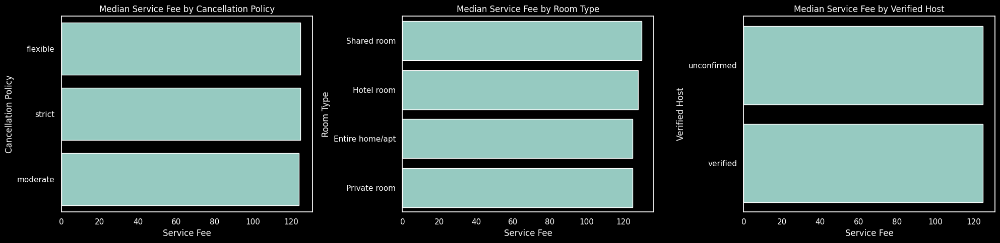

In [ ]:
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))

# Plot for cancellation policy
data_summary = data.groupby('cancellation_policy')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='cancellation_policy', x='service_fee', ax=axes[0])
axes[0].set_title('Median Service Fee by Cancellation Policy')
axes[0].set_xlabel('Service Fee')
axes[0].set_ylabel('Cancellation Policy')

# Plot for room type
data_summary = data.groupby('room_type')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='room_type', x='service_fee', ax=axes[1])
axes[1].set_title('Median Service Fee by Room Type')
axes[1].set_xlabel('Service Fee')
axes[1].set_ylabel('Room Type')

# Plot for room type
data_summary = data.groupby('host_identity_verified')['service_fee'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, y='host_identity_verified', x='service_fee', ax=axes[2])
axes[2].set_title('Median Service Fee by Verified Host')
axes[2].set_xlabel('Service Fee')
axes[2].set_ylabel('Verified Host')

plt.tight_layout()
plt.show()

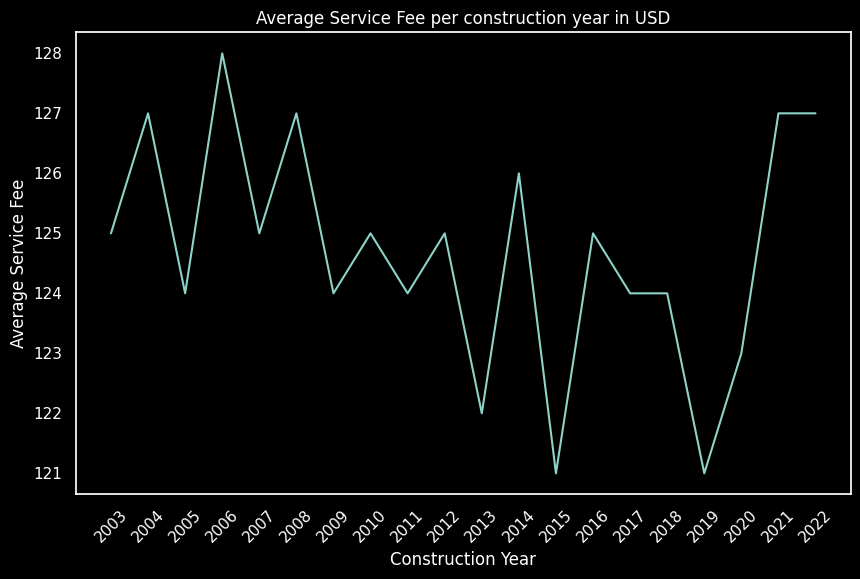

In [ ]:
price_per_year = data.groupby('construction_year')['service_fee'].median().reset_index()

plt.figure(figsize=(10, 6))
sns.lineplot(data=price_per_year, x="construction_year", y="service_fee")
plt.title("Average Service Fee per construction year in USD")
plt.xlabel("Construction Year")
plt.ylabel("Average Service Fee")
plt.xticks(ticks = price_per_year["construction_year"], rotation=45)
plt.show()

### Review Analysis

In [ ]:
data[["number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]].head()

,number_of_reviews,last_review,reviews_per_month,review_rate_number
0,9.0,2021-10-19,0.21,4.0
1,45.0,2022-05-21,0.38,4.0
2,0.0,NaT,NaN,5.0
3,270.0,2019-07-05,4.64,4.0
4,9.0,2018-11-19,0.10,3.0


In [ ]:
data[["number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]].describe()

,number_of_reviews,reviews_per_month,review_rate_number
count,101930.000000,86285.00000,101787.000000
mean,27.495242,1.37567,3.279142
std,49.544249,1.74833,1.284519
min,0.000000,0.01000,1.000000
25%,1.000000,0.22000,2.000000
50%,7.000000,0.74000,3.000000
75%,30.000000,2.01000,4.000000
max,1024.000000,90.00000,5.000000


#### Number of Reviews

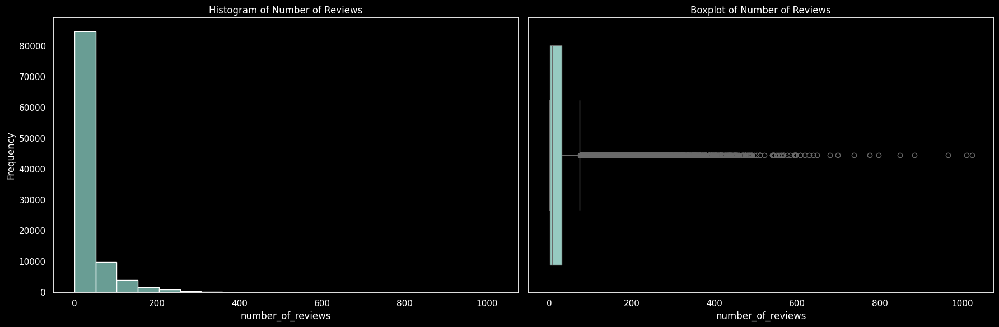

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["number_of_reviews"], bins=20)
plt.title('Histogram of Number of Reviews')
plt.xlabel("number_of_reviews")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "number_of_reviews")
plt.title('Boxplot of Number of Reviews')
plt.xlabel("number_of_reviews")
plt.ylabel('')

plt.tight_layout()
plt.show()

In [ ]:
data.loc[data["number_of_reviews"] == 0, ["number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]]

,number_of_reviews,last_review,reviews_per_month,review_rate_number
2,0.0,NaT,NaN,5.0
20,0.0,NaT,NaN,3.0
27,0.0,NaT,NaN,NaN
37,0.0,NaT,NaN,NaN
39,0.0,NaT,NaN,3.0
...,...,...,...,...
102590,0.0,NaT,NaN,1.0
102592,0.0,NaT,NaN,2.0
102594,0.0,NaT,NaN,3.0
102596,0.0,NaT,NaN,5.0


In [ ]:
print(round((len(data.loc[data["number_of_reviews"] == 0]) / len(data)) * 100, 2), "% of the listings have 0 reviews.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"].notna())]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"].isna())]) / len(data)) * 100, 2), "% of the listings have 0 reviews and don't have a review_rate_number.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"] == 5)]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number of 5.")
print(round((len(data.loc[(data["number_of_reviews"] == 0) & (data["review_rate_number"] == 0)]) / len(data)) * 100, 2), "% of the listings have 0 reviews but have a review_rate_number of 0.")

15.36 % of the listings have 0 reviews.
15.33 % of the listings have 0 reviews but have a review_rate_number.
0.03 % of the listings have 0 reviews and don't have a review_rate_number.
3.51 % of the listings have 0 reviews but have a review_rate_number of 5.
0.0 % of the listings have 0 reviews but have a review_rate_number of 0.


Only 0.03% of all rows have a missing value for review_rate_number when their number_of_reviews is equal to zero, and 3.51% have a value of 5. It would be expected that when there are no reviews the review_rate_number would either be NaN due to the lack of reviews or be set automatically to 5 or to 0; however, the amount of rows containing this logic is very low.

<ipython-input-42-c0f2d486fcd8>:3: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_temp_corrmatrix = data.loc[data["number_of_reviews"] != 0, cols_review].corr()
<ipython-input-42-c0f2d486fcd8>:4: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  data_corrmatrix2 = data[cols_review].corr()


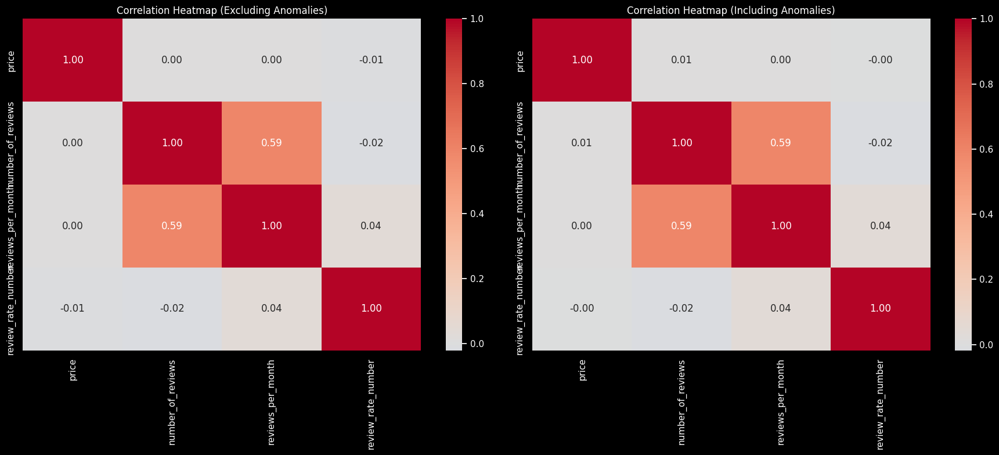

In [ ]:
# To see if there is a difference in correlation with & without
cols_review = ["price", "number_of_reviews", "last_review", "reviews_per_month", "review_rate_number"]
data_temp_corrmatrix = data.loc[data["number_of_reviews"] != 0, cols_review].corr()
data_corrmatrix2 = data[cols_review].corr()

fig, axes = plt.subplots(1, 2, figsize=(18, 8))

sns.heatmap(data_temp_corrmatrix, annot=True, cmap="coolwarm", fmt=".2f", center=0, ax=axes[0])
axes[0].set_title("Correlation Heatmap (Excluding Anomalies)")

sns.heatmap(data_corrmatrix2, annot=True, cmap="coolwarm", fmt=".2f", center=0, ax=axes[1])
axes[1].set_title("Correlation Heatmap (Including Anomalies)")

plt.tight_layout()
plt.show()

In [ ]:
# Set all values to zero
data.loc[data["number_of_reviews"]==0, "review_rate_number"] = 0

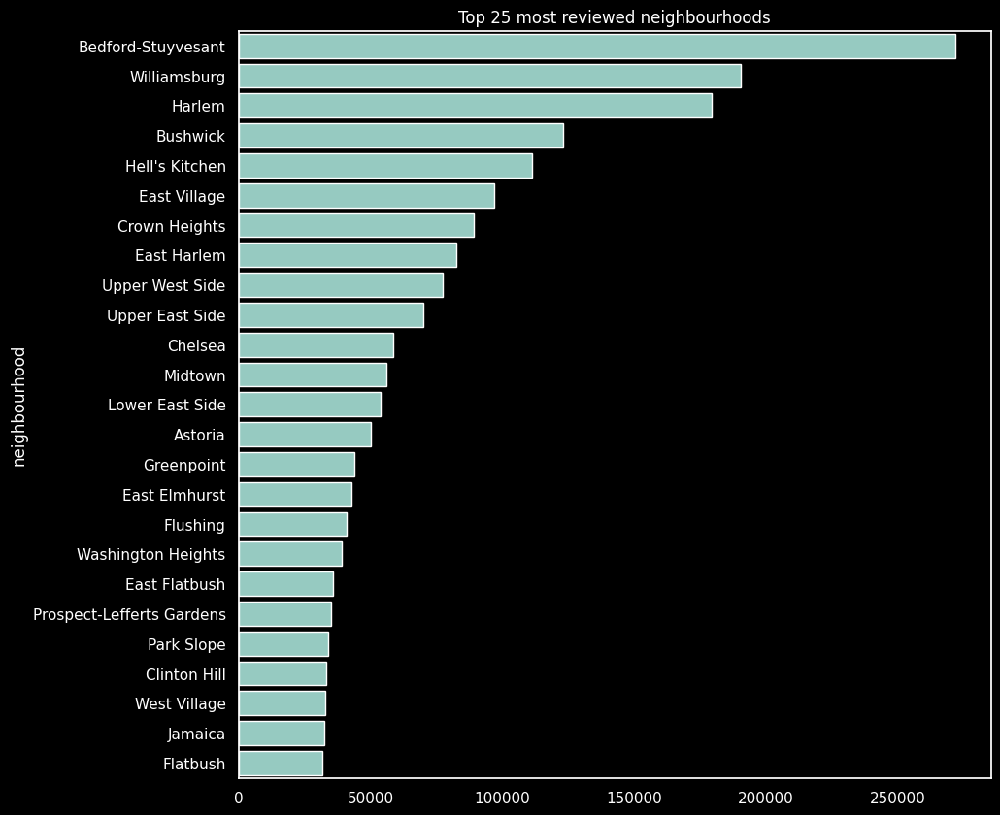

In [ ]:
top_25_reviewed_neighbourhoods = data.loc[data["number_of_reviews"] > 0].groupby(['neighbourhood'])['number_of_reviews'].sum().sort_values(ascending=False).head(25)
plt.figure(figsize=(10,10))
plt.title("Top 25 most reviewed neighbourhoods")
sns.barplot(x=top_25_reviewed_neighbourhoods.values,y=top_25_reviewed_neighbourhoods.index)
plt.show()

#### Review Rate Number

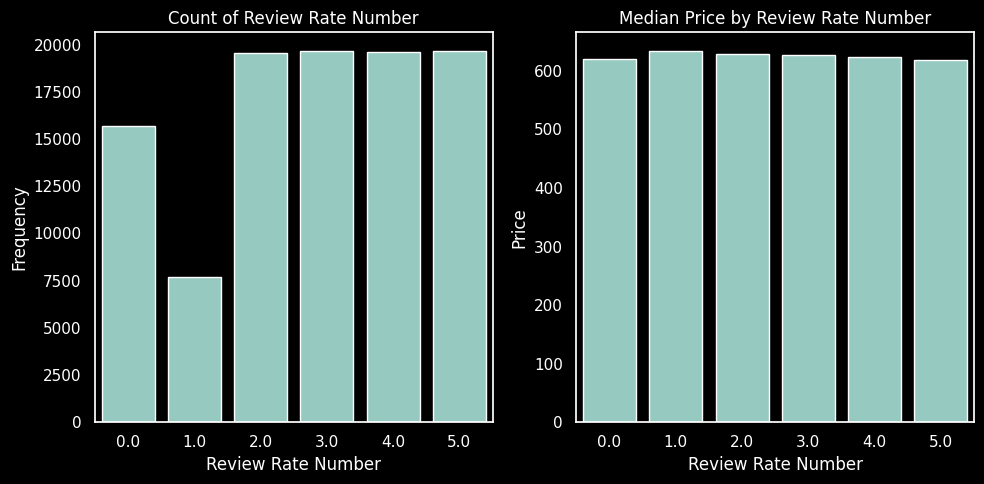

In [ ]:
plt.figure(figsize=(10, 5))

# Plot count plot for 'review_rate_number' column
plt.subplot(1, 2, 1)
sns.countplot(data=data, x='review_rate_number')
plt.title('Count of Review Rate Number')
plt.xlabel('Review Rate Number')
plt.ylabel('Frequency')

# Plot bar plot for median price by review_rate_number
plt.subplot(1, 2, 2)
data_summary = data.groupby('review_rate_number')['price'].median().sort_values(ascending=False).reset_index()
sns.barplot(data=data_summary, x='review_rate_number', y='price')
plt.title('Median Price by Review Rate Number')
plt.xlabel('Review Rate Number')
plt.ylabel('Price')

plt.tight_layout()
plt.show()

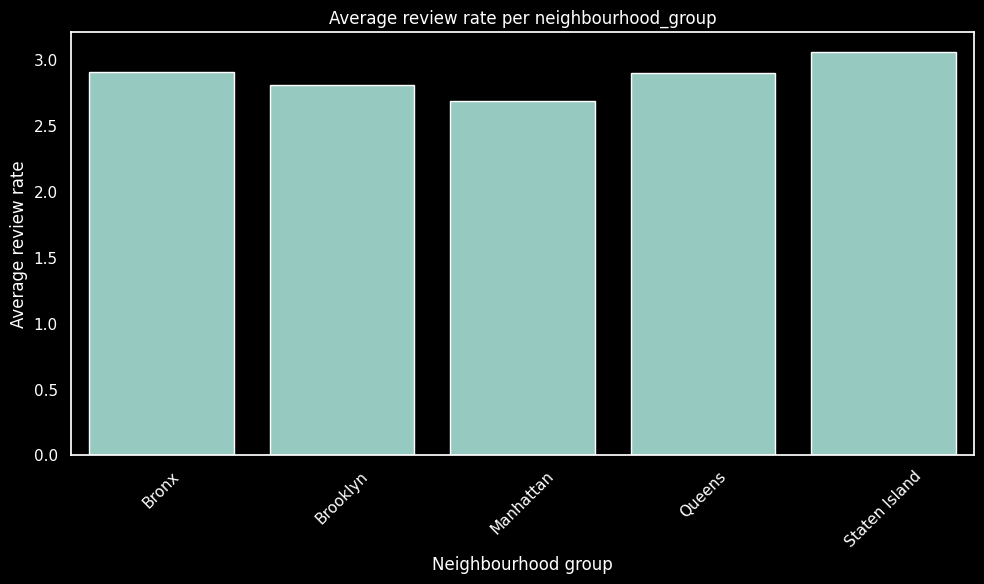

In [ ]:
review_rate_per_neighbourhood_group = data.groupby('neighbourhood_group')['review_rate_number'].mean().reset_index()

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(data=review_rate_per_neighbourhood_group, x='neighbourhood_group', y='review_rate_number')
plt.xlabel('Neighbourhood group')
plt.ylabel('Average review rate')
plt.title('Average review rate per neighbourhood_group')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

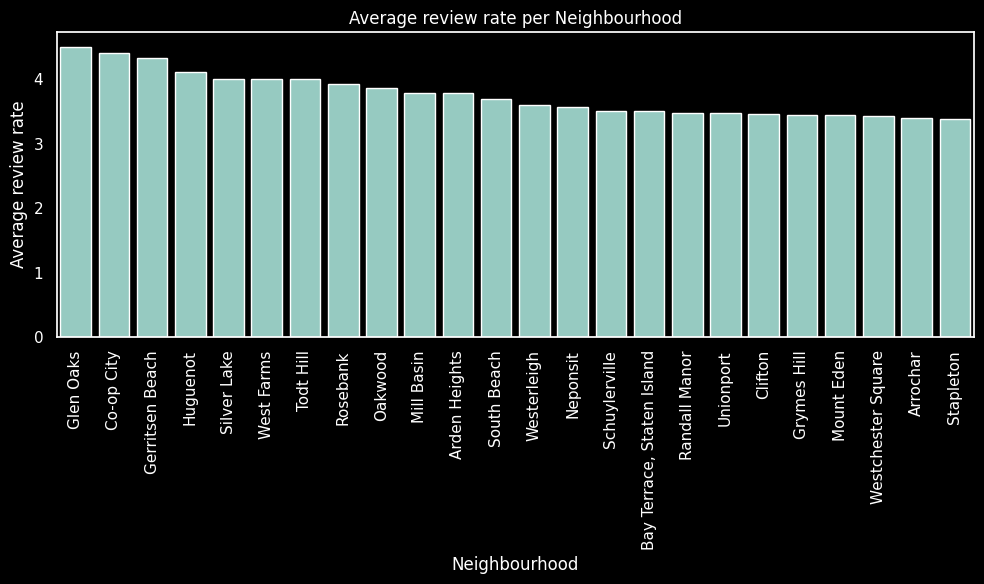

In [ ]:
avg_rating_per_neighbourhood = data.groupby(['neighbourhood'])['review_rate_number'].mean().sort_values(ascending=False)[0:24]

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(y = avg_rating_per_neighbourhood.values, x=avg_rating_per_neighbourhood.index)
plt.xlabel('Neighbourhood')
plt.ylabel('Average review rate')
plt.title('Average review rate per Neighbourhood')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

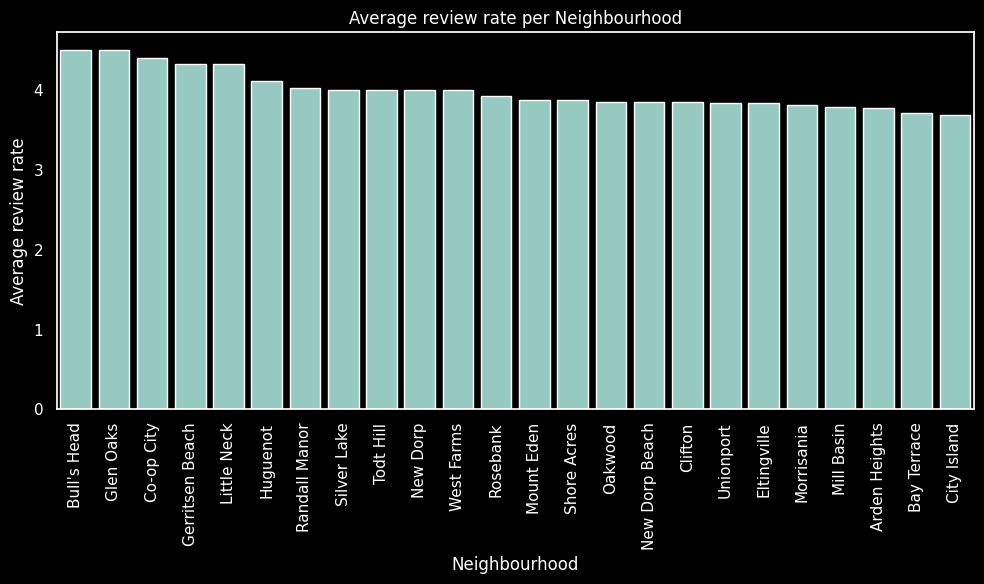

In [ ]:
# Testing to see if there is a difference here based on number_of_reviews being 0 based on analysis before
avg_rating_per_neighbourhood = data.loc[data["number_of_reviews"] > 0].groupby(['neighbourhood'])['review_rate_number'].mean().sort_values(ascending=False)[0:24]

# Plot using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(y = avg_rating_per_neighbourhood.values, x=avg_rating_per_neighbourhood.index)
plt.xlabel('Neighbourhood')
plt.ylabel('Average review rate')
plt.title('Average review rate per Neighbourhood')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

#### Reviews per Month

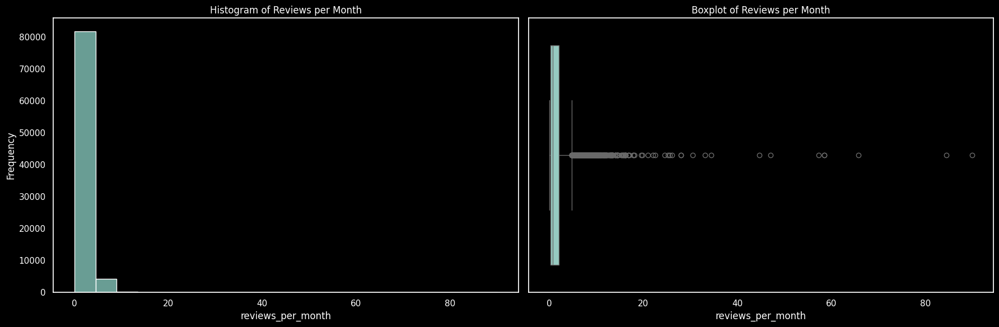

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["reviews_per_month"], bins=20)
plt.title('Histogram of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "reviews_per_month")
plt.title('Boxplot of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('')

plt.tight_layout()
plt.show()

In [ ]:
# Decide what to do with the outliers reviews_per_month >> its impossible that there are more than 15 reviews_per_month given that the minimum stay is 3 (refine this based on actual data)
print(len(data.loc[data["reviews_per_month"] >= 15]), "listings have more than 15 reviews_per_month and are considered anomalies.")

41 listings have more than 15 reviews_per_month and are considered anomalies.


In [ ]:
data = data.loc[data["reviews_per_month"] <= 15]

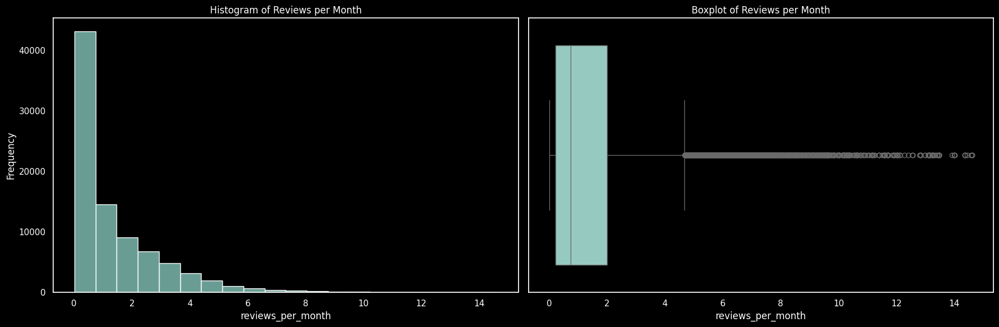

In [ ]:
plt.figure(figsize=(18, 6))

# Histogram
plt.subplot(1, 2, 1)
sns.histplot(data["reviews_per_month"], bins=20)
plt.title('Histogram of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('Frequency')

# Boxplot
plt.subplot(1, 2, 2)
sns.boxplot(data=data, x= "reviews_per_month")
plt.title('Boxplot of Reviews per Month')
plt.xlabel("reviews_per_month")
plt.ylabel('')

plt.tight_layout()
plt.show()

#### Last Review

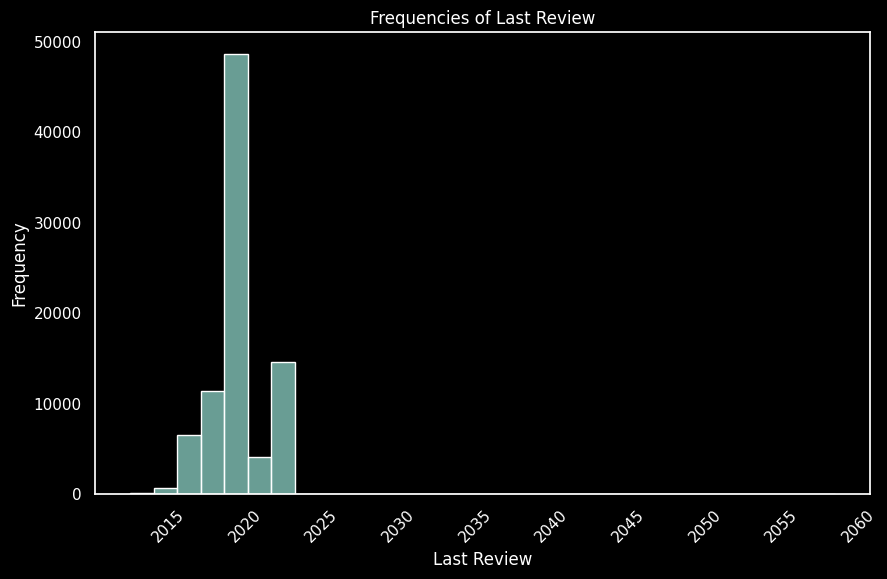

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(data['last_review'], bins=30, kde=False)
plt.title('Frequencies of Last Review')
plt.xlabel('Last Review')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Understanding which is last year of review
print(len(data.loc[(data["last_review"] >= "2021-01-01") & (data["last_review"] <= "2021-12-31")]), "listings have last_review date in 2021.")
print(len(data.loc[(data["last_review"] >= "2022-01-01") & (data["last_review"] <= "2022-12-31")]), "listings have last_review date in 2022.")
print(len(data.loc[(data["last_review"] >= "2023-01-01") & (data["last_review"] <= "2023-12-31")]), "listings have last_review date in 2023.")
print(len(data.loc[(data["last_review"] >= "2024-01-01") & (data["last_review"] <= "2024-12-31")]), "listings have last_review date in 2024.")
print(len(data.loc[(data["last_review"] >= "2025-01-01") & (data["last_review"] <= "2025-12-31")]), "listings have last_review date in 2025.")

6585 listings have last_review date in 2021.
10335 listings have last_review date in 2022.
0 listings have last_review date in 2023.
1 listings have last_review date in 2024.
1 listings have last_review date in 2025.


In [ ]:
# Assuming that the last review date is 2022
print(len(data.loc[data["last_review"] >= "2023-01-01"]), "listings have last_review date after 2022 and are considered anomalies.")

5 listings have last_review date after 2022 and are considered anomalies.


In [ ]:
data = data.loc[data["last_review"] <= "2022-12-31"]

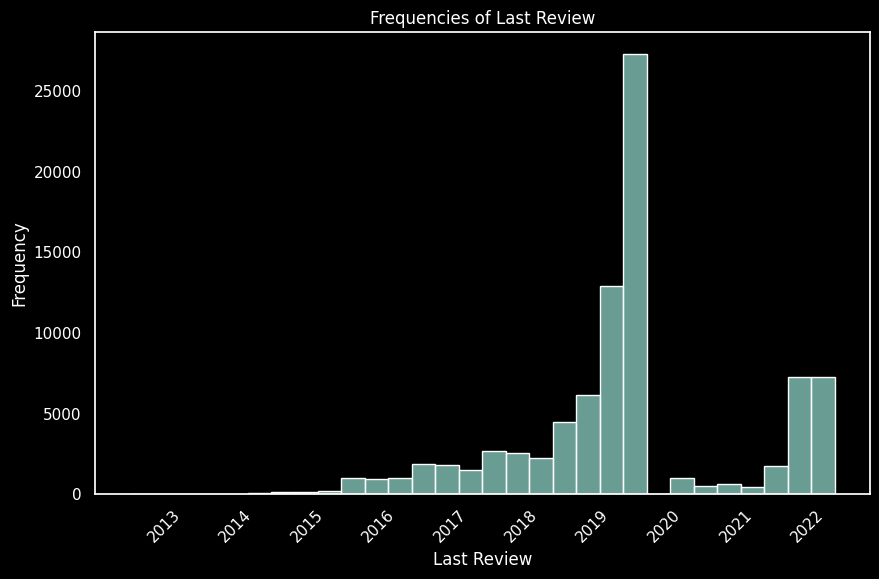

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(data['last_review'], bins=30, kde=False)
plt.title('Frequencies of Last Review')
plt.xlabel('Last Review')
plt.ylabel('Frequency')
plt.xticks(rotation=45)
plt.show()

## Roberto: *Booking type, Cancellation policy, Room type & Construction year*


### Booking type

In [ ]:
instant_bookable = data["instant_bookable"].value_counts()
fig = px.pie(
    values = instant_bookable.values,
    names = instant_bookable.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Instantly bookable',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
fig = px.box(
    x=data["instant_bookable"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'Instantly bookable?')
fig.update_layout(
    xaxis_title = "booking policy",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table('price', index='instant_bookable', columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
#Encoding for modelling
data["instant_bookable"] = data["instant_bookable"].apply(lambda x: 1 if x == True else 0)

### Cancellation policy

In [ ]:
#drop missing cancellation_policy rows
data['cancellation_policy'].isna().sum()
data = data.dropna(subset=['cancellation_policy'])

In [ ]:
cancellation_policy = data["cancellation_policy"].value_counts()
fig = px.pie(
    values = cancellation_policy.values,
    names = cancellation_policy.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Cancellation policy distribution',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
fig = px.box(
    x=data["cancellation_policy"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'cancellation policy compared to the price')
fig.update_layout(
    xaxis_title = "concellation policy",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index="cancellation_policy", columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
data['cancellation_policy'].value_counts()

moderate    28855
strict      28673
flexible    28623
Name: cancellation_policy, dtype: int64

In [ ]:
#Encoding for modelling: 0: flexible, 1: moderate, 2: strict
cancellation_policy_le = LabelEncoder()
data['cancellation_policy'] = cancellation_policy_le.fit_transform(data['cancellation_policy'])
data['cancellation_policy'].value_counts()

1    28855
2    28673
0    28623
Name: cancellation_policy, dtype: int64

### Room type

In [ ]:
rm = data["room_type"].value_counts()
fig = px.bar(y = rm.values,
             x = rm.index,
             color = rm.index,
             color_discrete_sequence=px.colors.diverging.RdBu,
             text = rm.values,
             title = "Room type",
             template = "plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [ ]:
room_type = data["room_type"].value_counts()
fig = px.pie(
    values = room_type.values,
    names = room_type.index,
    color_discrete_sequence=px.colors.diverging.RdBu,
    title= 'Room type distribution',template='plotly_dark'
)
fig.update_layout(
    font=dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
#a map on room types
fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood_group",
           hover_data=["neighbourhood_group", "room_type"],
           color="room_type",
            color_discrete_sequence=px.colors.qualitative.Dark24,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17,family="Franklin Gothic"))
fig.show()

In [ ]:
#Room types compared to the price
fig = px.box(
    x=data["room_type"],
    y=data['price'],
    template= 'plotly_dark',
    title = 'Room type compared to the price')
fig.update_layout(
    xaxis_title = "Room type",
    yaxis_title = "price",
    font = dict(size=17, family="Franklin Gothic"))
fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index="room_type", columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Choose a sequential color scale
                title="Mean Price by Instant Bookable and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=500)
fig.show()

In [ ]:
data['room_type'].value_counts()

Entire home/apt    45576
Private room       38764
Shared room         1704
Hotel room           107
Name: room_type, dtype: int64

In [ ]:
#Encoding for modelling  0: Entire home/apt, 1: Hotel room, 2: Private room, 3: Shared room
room_type_le = LabelEncoder()
data['room_type'] = room_type_le.fit_transform(data['room_type'])
data['room_type'].value_counts()

0    45576
2    38764
3     1704
1      107
Name: room_type, dtype: int64

### Construction year

In [ ]:
fig = px.histogram(data, x='construction_year', color='construction_year', color_discrete_sequence=px.colors.diverging.RdBu,
                   title="Construction Year Distribution", template="plotly_dark", range_y=[4800, 5400])
fig.update_layout(
    xaxis_title="Construction Year",
    yaxis_title="Count",
    font=dict(size=17, family="Franklin Gothic")
)
fig.show()

In [ ]:
price_per_year = data.groupby('construction_year')['price'].median()
fig = px.line(price_per_year,
            x=price_per_year.index,
            y=price_per_year.values,
            labels={'x': 'Construction year', 'y': 'Average price'},
            text=['$' + str(int(i)) for i in price_per_year.values],
            title='Average price per construction year in USD',
            color_discrete_sequence=px.colors.sequential.Teal_r,
            template='plotly_dark'
)

fig.update_layout(font=dict(size=16, color='white', family='Avenir'))

fig.show()

In [ ]:
pivot_table = data.pivot_table("price", index='construction_year', columns='neighbourhood_group', aggfunc='mean', margins=True)

# Plot heatmap with sequential colors using Plotly Express
fig = px.imshow(pivot_table,
                labels=dict(color="Mean Price"),
                x=pivot_table.columns,
                y=pivot_table.index,
                color_continuous_scale='Viridis',  # Use the 'Viridis' color scale
                title="Mean Price by Construction Year and Neighbourhood Group",
                template="plotly_dark",
                width=800,
                height=800)
fig.show()

## Fabrizio - Location Analysis

In [ ]:
country_columns = ['country', 'country_code', 'lat', 'long', 'neighbourhood', 'neighbourhood_group']
data.dropna(subset=country_columns, inplace=True)

In [ ]:
data['neighbourhood_group'].value_counts()

Brooklyn         35564
Manhattan        35542
Queens           11370
Bronx             2336
Staten Island      839
Name: neighbourhood_group, dtype: int64

In [ ]:
unique_neighbourhood_counts = data.groupby('neighbourhood_group')['neighbourhood'].nunique()
unique_neighbourhood_counts

neighbourhood_group
Bronx            48
Brooklyn         48
Manhattan        32
Queens           52
Staten Island    43
Name: neighbourhood, dtype: int64

In [ ]:
unique_neighbourhood_counts = data.groupby('neighbourhood_group')['neighbourhood'].count()
unique_neighbourhood_counts

neighbourhood_group
Bronx             2336
Brooklyn         35564
Manhattan        35542
Queens           11370
Staten Island      839
Name: neighbourhood, dtype: int64

In [ ]:
data.drop(['country', 'country_code'], axis=1, inplace=True)

In [ ]:
data['lat'].describe()

count    85651.000000
mean        40.727422
std          0.056355
min         40.504560
25%         40.687670
50%         40.721350
75%         40.762670
max         40.916970
Name: lat, dtype: float64

In [ ]:
data['long'].describe()

count    85651.000000
mean       -73.948548
std          0.050308
min        -74.249840
25%        -73.982110
50%        -73.953730
75%        -73.930945
max        -73.705220
Name: long, dtype: float64

In [ ]:
data.price.describe()

count    85651.000000
mean       625.949948
std        331.797984
min         50.000000
25%        340.000000
50%        625.000000
75%        914.000000
max       1200.000000
Name: price, dtype: float64

In [ ]:
#Plot char on the neighbourhood group :
ng = data["neighbourhood_group"].value_counts()
fig = px.bar(y = ng.values,
             x = ng.index,
             color = ng.index,
             color_discrete_sequence=px.colors.sequential.PuBuGn,
             text = ng.values,
             template="plotly_dark"
             )
fig.update_layout(
    xaxis_title = "Neighbourhood group",
    yaxis_title = "count",
    font = dict(size=17,family="Franklin Gothic")
    )
fig.show()

In [ ]:
#Comparing the price and place :
fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity = 0.3,
           hover_name="neighbourhood_group",
           hover_data=["neighbourhood_group", "price"],
           color="price",
           color_discrete_sequence=px.colors.sequential.PuBuGn,
           title = "Price comparing to the place",
           template = "plotly_dark",
           zoom=10
           )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0},font = dict(size=17))
fig.show()

In [ ]:
# Group data by neighborhood and calculate descriptive statistics for price
price_stats_by_neighborhood = data.groupby('neighbourhood_group')['price'].describe()

# Display the statistics
price_stats_by_neighborhood

,count,mean,std,min,25%,50%,75%,max
neighbourhood_group,,,,,,,,
Bronx,2336.0,626.946490,325.569330,50.0,350.00,633.0,906.0,1200.0
Brooklyn,35564.0,627.350101,331.748916,50.0,342.00,626.0,914.0,1200.0
Manhattan,35542.0,623.057622,331.144581,50.0,338.00,622.0,911.0,1200.0
Queens,11370.0,630.492084,335.585240,50.0,337.25,630.0,924.0,1200.0
Staten Island,839.0,624.796186,326.748544,50.0,348.50,628.0,910.0,1200.0


In [ ]:
fig = px.box(data,
             x='price',
             y='neighbourhood_group',
             title='Price Distribution by Neighbourhood',
             template="plotly_dark")
fig.update_traces(quartilemethod="inclusive")
fig.show()

In [ ]:
#mean price by neighbourhood
mean_price_by_neighbourhood = data.groupby('neighbourhood')['price'].mean().sort_values(ascending=False)

# Display the mean price by neighbourhood
mean_price_by_neighbourhood

neighbourhood
New Dorp                  1048.000000
Chelsea, Staten Island    1042.000000
Little Neck                906.333333
New Dorp Beach             856.714286
Riverdale                  840.923077
                             ...     
Castle Hill                308.000000
Rossville                  300.666667
Spuyten Duyvil             293.444444
Lighthouse Hill            107.666667
Woodrow                     78.000000
Name: price, Length: 223, dtype: float64

In [ ]:
# Lowercase conversion for uniformity
data['neighbourhood'] = data['neighbourhood'].str.lower()

# Inspect unique values for anomalies
print(data['neighbourhood'].unique())

data['neighbourhood'] = data['neighbourhood'].replace({'chelsea, staten island': 'chelsea'})

['kensington' 'midtown' 'clinton hill' 'east harlem' 'murray hill'
 'bedford-stuyvesant' "hell's kitchen" 'upper west side' 'chinatown'
 'south slope' 'bushwick' 'lower east side' 'east village' 'fort greene'
 'harlem' 'prospect-lefferts gardens' 'long island city' 'williamsburg'
 'greenpoint' 'kips bay' 'soho' 'chelsea' 'upper east side'
 'prospect heights' 'park slope' 'flatbush' 'brooklyn heights' 'gowanus'
 'washington heights' 'west village' 'flatlands' 'carroll gardens'
 'st. george' 'highbridge' 'financial district' 'ridgewood'
 'morningside heights' 'jamaica' 'flatiron district' 'windsor terrace'
 'roosevelt island' 'greenwich village' 'little italy' 'east flatbush'
 'tompkinsville' 'astoria' 'crown heights' 'inwood' 'kingsbridge'
 'boerum hill' 'two bridges' 'rockaway beach' 'nolita' 'woodlawn'
 'sunnyside' 'university heights' 'gramercy' 'allerton' 'east new york'
 'theater district' 'concourse village' 'sheepshead bay' 'emerson hill'
 'fort hamilton' 'bensonhurst' 'tribeca' 

In [ ]:
#analysis of neighbourhood
data['neighbourhood'].value_counts()

bedford-stuyvesant    6926
williamsburg          6520
harlem                4719
bushwick              4082
hell's kitchen        3259
                      ... 
willowbrook              3
gerritsen beach          3
glen oaks                2
woodrow                  1
new dorp                 1
Name: neighbourhood, Length: 222, dtype: int64

In [ ]:
#create a mean neighbourhood price column
mean_price_by_neighbourhood = data.groupby('neighbourhood')['price'].mean().sort_values(ascending=False).round(2)
mean_price_by_neighbourhood = mean_price_by_neighbourhood.reset_index()

# Display the mean price by neighbourhood
mean_price_by_neighbourhood

,neighbourhood,price
0,new dorp,1048.00
1,little neck,906.33
2,new dorp beach,856.71
3,riverdale,840.92
4,arden heights,804.89
...,...,...
217,castle hill,308.00
218,rossville,300.67
219,spuyten duyvil,293.44
220,lighthouse hill,107.67


In [ ]:
fig = px.histogram(mean_price_by_neighbourhood, x='price',
                   nbins=20,  # Number of bins
                   title='Price Distribution by Neighbourhood',
                   labels={'price': 'Price ($)'},
                   template='plotly_dark')  # Using a simple white background

fig.update_layout(xaxis_title='Mean Price ($)',
                  yaxis_title='Count',
                  bargap=0.2)

fig.show()

In [ ]:
#insert the mean price by neighbourhood into the dataframe
data = pd.merge(data, mean_price_by_neighbourhood, on='neighbourhood', how='left')

In [ ]:
data.rename(columns={'price_x': 'price', 'price_y': 'mean_neighbourhood_price'}, inplace=True)

In [ ]:
# Use qcut to create quartile-based bins
data['price_bin'] = pd.qcut(data['mean_neighbourhood_price'], q=6, precision=0)

# Check the bin ranges and counts
price_bin_counts = data['price_bin'].value_counts().sort_index()

price_bin_counts

(77.0, 616.0]      15398
(616.0, 622.0]     15581
(622.0, 625.0]     17637
(625.0, 627.0]      8595
(627.0, 640.0]     14275
(640.0, 1048.0]    14165
Name: price_bin, dtype: int64

In [ ]:
data['price_bin'] = data['price_bin'].astype(str)

fig = px.scatter_mapbox(data,
           lat="lat",
           lon="long",
           opacity=0.3,
           hover_name="neighbourhood",
           hover_data=["neighbourhood", "price_bin"],  # Adjusted to include "Price Bin"
           color="price_bin",  # Now coloring by "Price Bin"
           color_discrete_sequence=px.colors.qualitative.Plotly,  # Using a discrete color sequence
           title="Neighbourhoods and Price Bins Distribution",
           template="plotly_dark",
           zoom=10
          )
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, font=dict(size=17, family="Franklin Gothic"))
fig.show()

## Modeling


In [ ]:
x = data.drop(["price"], axis=1)
y = data["price"]

x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

In [ ]:
robust_scaler = RobustScaler()
x_train = robust_scaler.fit_transform(x_train)
x_test = robust_scaler.transform(x_test)

ValueError: could not convert string to float: 'Fun Clinton Hill One Bedroom with private entrance'

### 1. Linear Regression

In [ ]:
l_model = LinearRegression()
l_model.fit(x_train, y_train)

In [ ]:
#Used RMSE because it is in the same unit as price
y_pred = l_model.predict(x_test)
mean_squared_error(y_pred, y_test, squared=False)

In [ ]:
df = pd.DataFrame({"Y_test": y_test , "Y_pred" : y_pred})

plt.figure(figsize=(15,8))
plt.plot(df[:50])
plt.legend(['Actual' , 'Predicted'])

### 2. Decision Tree Regressor

In [ ]:
dt_model = DecisionTreeRegressor()
dt_model.fit(x_train, y_train)

In [ ]:
y_pred = dt_model.predict(x_test)
mean_squared_error(y_pred, y_test, squared=False)

In [ ]:
df = pd.DataFrame({"Y_test": y_test , "Y_pred" : y_pred})

plt.figure(figsize=(15,8))
plt.plot(df[:50])
plt.legend(['Actual' , 'Predicted'])

### 3. RandomForest Regressor

In [ ]:
rf_model = RandomForestRegressor()
rf_model.fit(x_train, y_train)

In [ ]:
y_pred = rf_model.predict(x_test)
mean_squared_error(y_pred, y_test, squared=False)

In [ ]:
df = pd.DataFrame({"Y_test": y_test , "Y_pred" : y_pred})

plt.figure(figsize=(15,8))
plt.plot(df[:50])
plt.legend(['Actual' , 'Predicted'])